# Trabalho Individual: Caracterização de Canal Sem Fio via CIRs

**Aluno:** João Lucas de Castro Santos  
**Data:** Novembro 2025  
**Fonte:** NIST - Industrial Wireless Systems Radio Propagation Measurements

---

## Resumo Executivo

Este notebook apresenta os **resultados completos** do trabalho de caracterização de canal sem fio a partir de medidas de CIRs obtidas em ambiente industrial (Steam Plant).

### Dados Utilizados
- **Dataset 1:** 10,530 CIRs com 20 taps
- **Dataset 2:** 10,530 CIRs com 8 taps
- **Total de outputs gerados:** 29 arquivos (18 figuras + 3 GIFs + 5 CSVs + 3 scripts)

In [1]:
# Imports para visualização
import pandas as pd
from IPython.display import Image, display, Markdown
import warnings
warnings.filterwarnings('ignore')

print("✓ Ambiente configurado")

✓ Ambiente configurado


---

# Parte I: Distribuições Estatísticas

## Objetivos
- Identificar distribuição estatística que melhor modela o ambiente
- Comparar Rayleigh, Rice e Nakagami
- Avaliar influência da resolução (20 vs 8 taps)

## Resultados: Dataset 20 taps

### Histograma - Dataset 20 taps

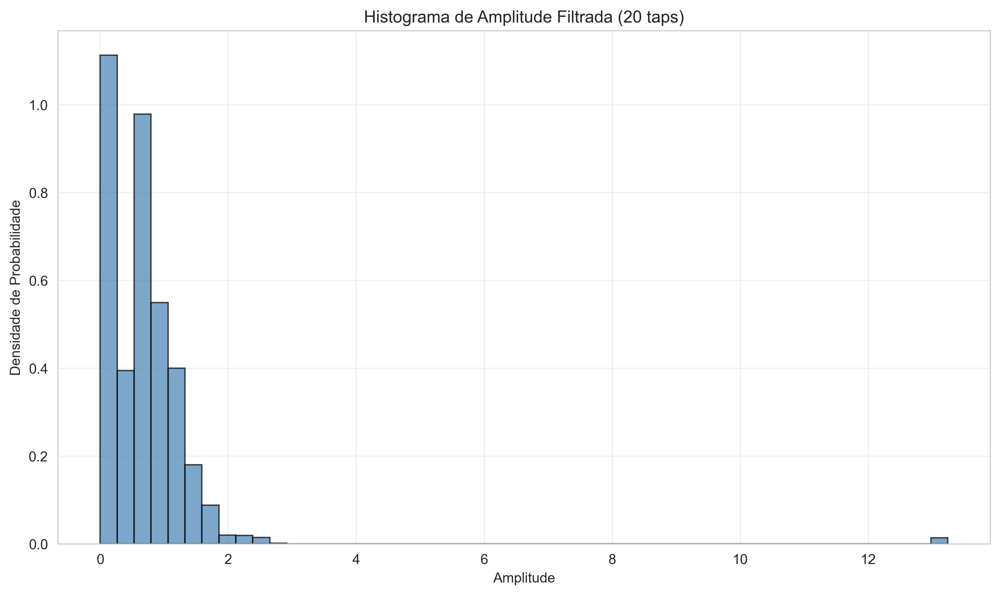

In [2]:
# Histograma e ajuste de distribuições
display(Markdown("### Histograma - Dataset 20 taps"))
display(Image(filename='../figures/parte1/histograma_20taps.png', width=800))

### CDFs - Método scipy.stats.fit (20 taps)

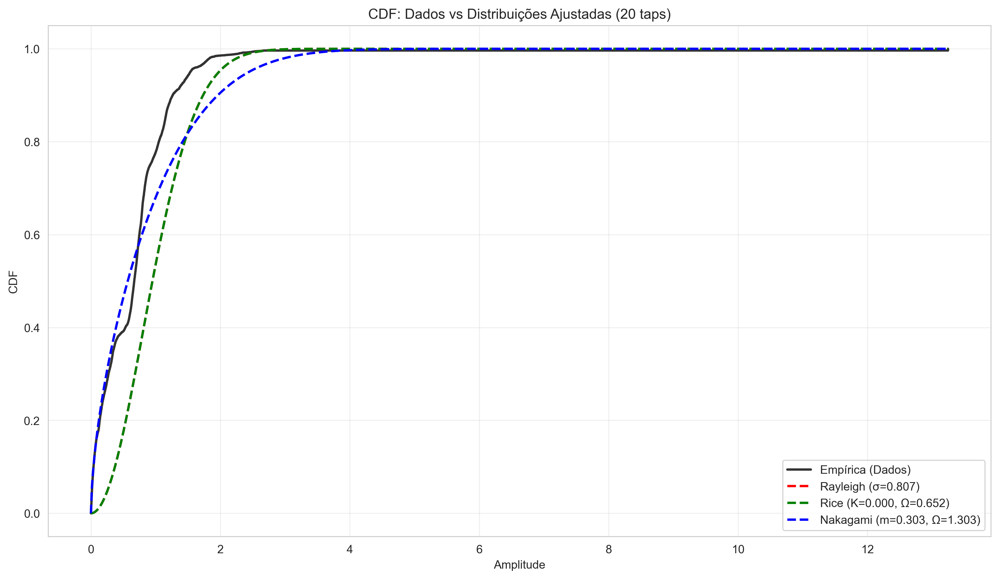

In [3]:
# CDFs - Método scipy
display(Markdown("### CDFs - Método scipy.stats.fit (20 taps)"))
display(Image(filename='../figures/parte1/cdf_scipy_20taps.png', width=800))

### CDFs - Método Envoltória Normalizada (20 taps)

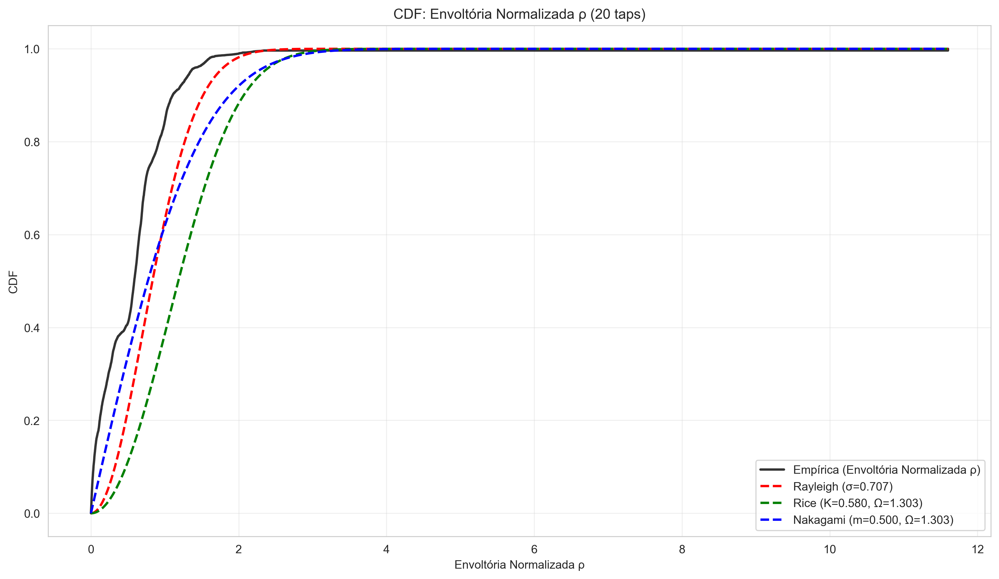

In [4]:
# CDFs - Método envoltória normalizada
display(Markdown("### CDFs - Método Envoltória Normalizada (20 taps)"))
display(Image(filename='../figures/parte1/cdf_normalizada_20taps.png', width=800))

## Resultados: Dataset 8 taps

### Histograma - Dataset 8 taps

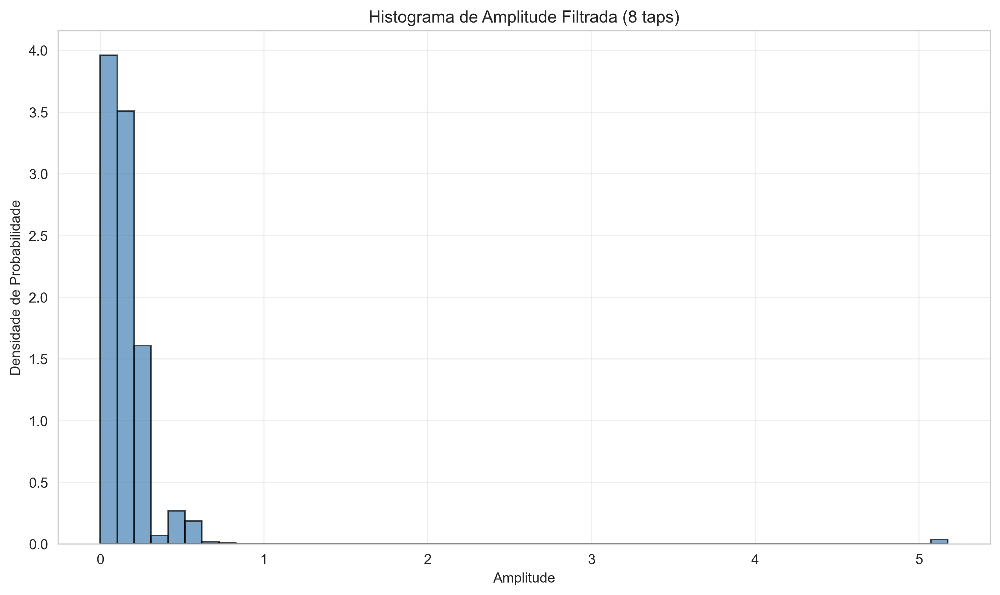

In [5]:
display(Markdown("### Histograma - Dataset 8 taps"))
display(Image(filename='../figures/parte1/histograma_8taps.png', width=800))

### CDFs - Dataset 8 taps

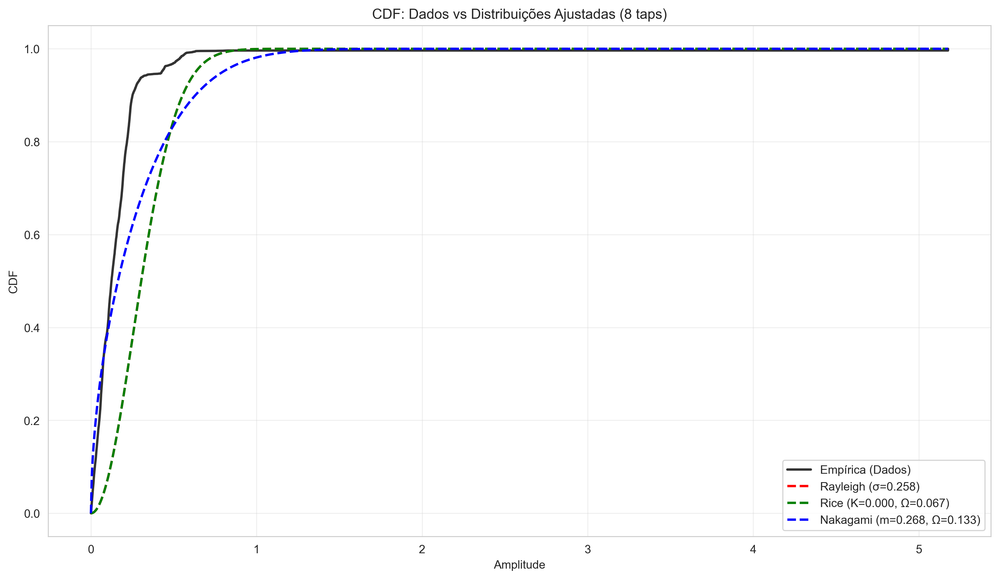

In [6]:
display(Markdown("### CDFs - Dataset 8 taps"))
display(Image(filename='../figures/parte1/cdf_scipy_8taps.png', width=800))

## Parâmetros Ajustados

In [7]:
# Carregar tabela de parâmetros
df_parte1 = pd.read_csv('../results/parte1_parametros.csv')
display(Markdown("### Tabela: Parâmetros das Distribuições"))
display(df_parte1.style.set_properties(**{'text-align': 'center'}))

### Tabela: Parâmetros das Distribuições

,dataset,metodo,distribuicao,parametro_1,parametro_2,sse
0,20 taps,scipy.stats,Rayleigh,0.807279,nan,453.314797
1,20 taps,scipy.stats,Rice,0.000001,0.651697,453.311546
2,20 taps,scipy.stats,Nakagami,0.303225,1.303344,50.649331
3,20 taps,dissertacao,Rayleigh,0.707107,nan,nan
4,20 taps,dissertacao,Rice,0.580378,1.303398,nan
5,20 taps,dissertacao,Nakagami,0.500000,1.303398,nan
6,8 taps,scipy.stats,Rayleigh,0.257985,nan,1348.096773
7,8 taps,scipy.stats,Rice,0.000000,0.066556,1348.096683
8,8 taps,scipy.stats,Nakagami,0.267649,0.133099,194.574392
9,8 taps,dissertacao,Rayleigh,0.707107,nan,nan


## Conclusões - Parte I

### 1. Melhor Distribuição: **Nakagami-m**
- **20 taps:** m = 0.303, SSE = 50.6
- **8 taps:** m = 0.268, SSE = 194.6

### 2. Interpretação
- **m < 1** indica **desvanecimento severo** (pior que Rayleigh)
- **K ≈ 0** (Rice) confirma ambiente **NLOS**
- Ambiente com multipercurso rico e reflexões intensas

### 3. Influência da Resolução
- Maior resolução (20 taps) resulta em melhor ajuste
- SSE 4x maior para 8 taps
- Conclusão qualitativa mantida (Nakagami é melhor)

---

# Parte II: Parâmetros de Caracterização do Canal

## Objetivos
- Calcular Power Delay Profile (PDP)
- Mean Excess Delay, RMS Delay Spread, Maximum Excess Delay
- Coherence Bandwidth
- Analisar seletividade em frequência

## Power Delay Profiles

### PDP - Dataset 20 taps

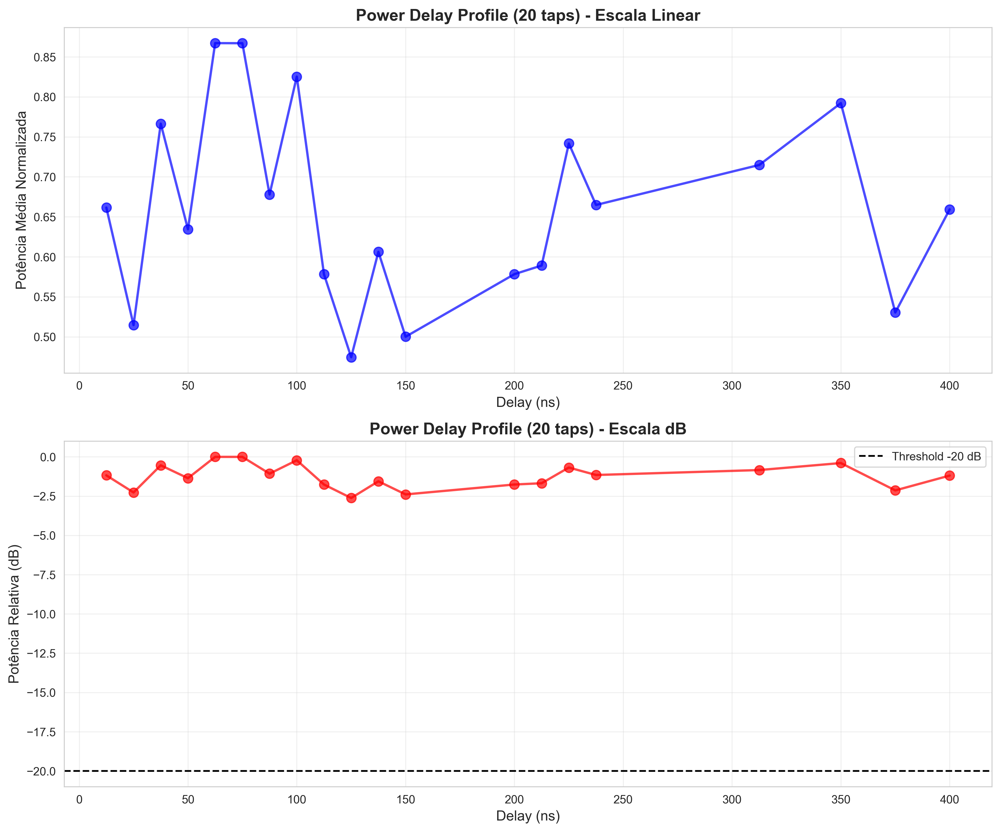

In [8]:
display(Markdown("### PDP - Dataset 20 taps"))
display(Image(filename='../figures/parte2/pdp_20taps.png', width=800))

### PDP - Dataset 8 taps

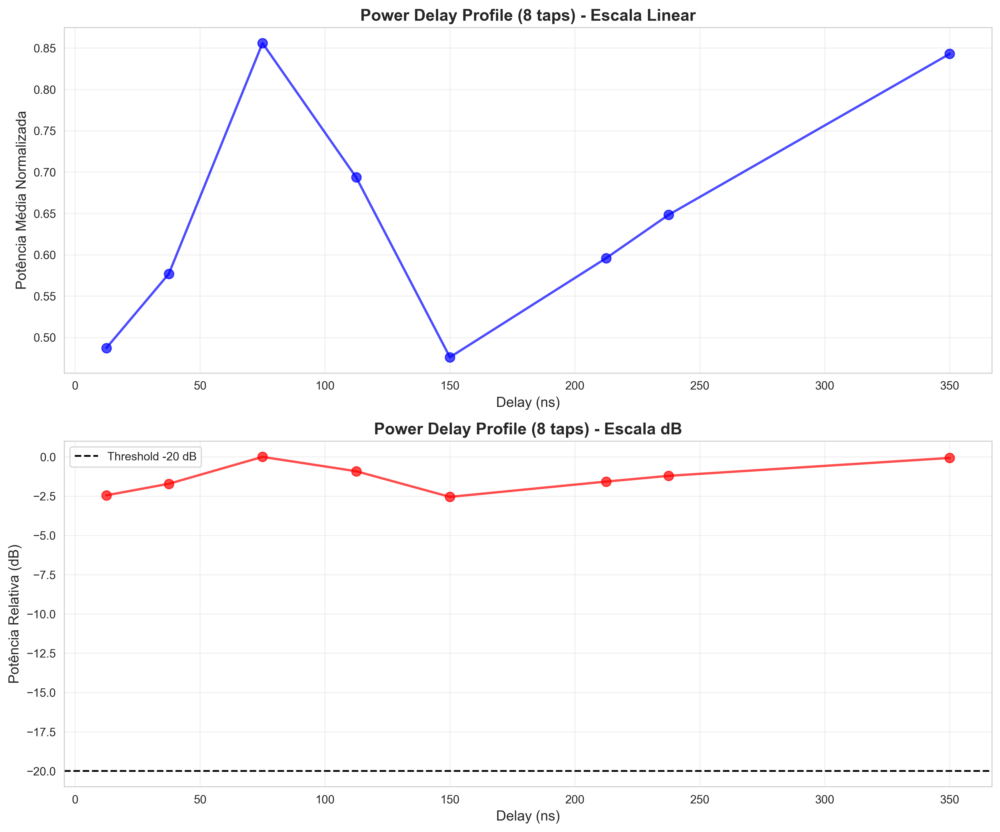

In [9]:
display(Markdown("### PDP - Dataset 8 taps"))
display(Image(filename='../figures/parte2/pdp_8taps.png', width=800))

### Comparação de PDPs

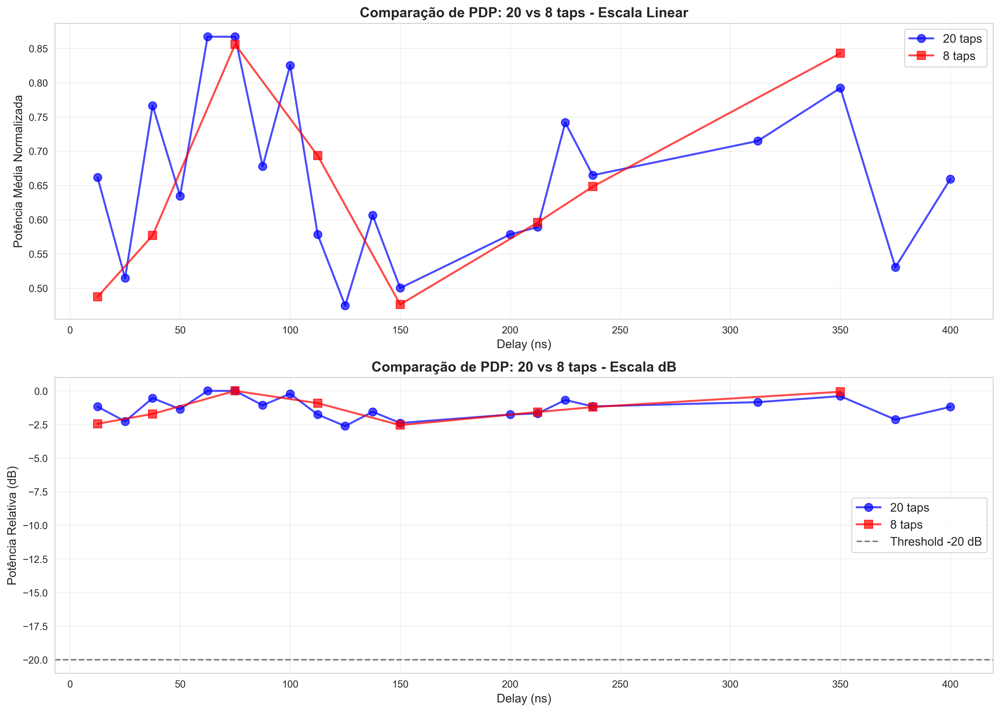

In [10]:
display(Markdown("### Comparação de PDPs"))
display(Image(filename='../figures/parte2/pdp_comparison.png', width=800))

## Parâmetros do Canal

In [11]:
# Tabela de parâmetros
df_parte2 = pd.read_csv('../results/parte2_parametros.csv')
display(Markdown("### Tabela: Parâmetros Calculados"))
display(df_parte2.style.set_properties(**{'text-align': 'center'}))

### Tabela: Parâmetros Calculados

,Parametro,20_taps,8_taps
0,Mean Excess Delay (ns),162.660408,157.814093
1,RMS Delay Spread (ns),117.719104,110.312044
2,Maximum Excess Delay (ns),400.000000,350.000000
3,Number of Taps,20.000000,8.000000
4,Delay Range Min (ns),12.500000,12.500000
5,Delay Range Max (ns),400.000000,350.000000


### Comparação de Parâmetros

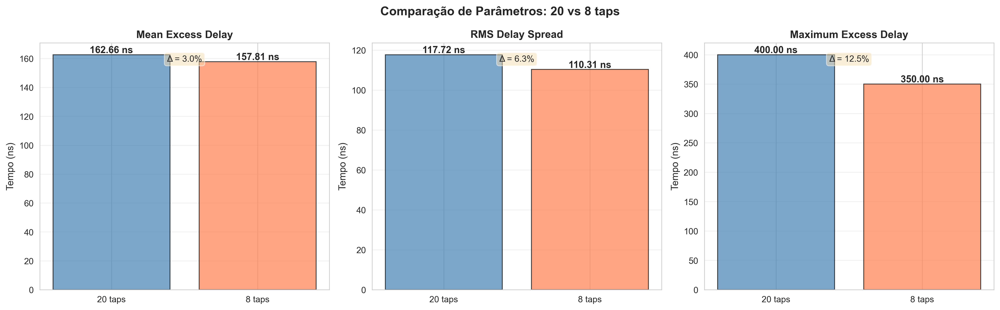

In [12]:
# Comparação visual
display(Markdown("### Comparação de Parâmetros"))
display(Image(filename='../figures/parte2/parameters_comparison.png', width=800))

In [13]:
# Tabela comparativa
df_comp = pd.read_csv('../results/parte2_comparacao.csv')
display(Markdown("### Tabela: Comparação 20 vs 8 taps"))
display(df_comp.style.set_properties(**{'text-align': 'center'}))

### Tabela: Comparação 20 vs 8 taps

,Parametro,20_taps,8_taps,diff_ns,diff_percent
0,mean_excess_delay,162.660408,157.814093,4.846314,2.979406
1,rms_delay_spread,117.719104,110.312044,7.407060,6.292147
2,maximum_excess_delay,400.000000,350.000000,50.000000,12.500000


## Animações de CIRs

### Animação: CIRs - 20 taps

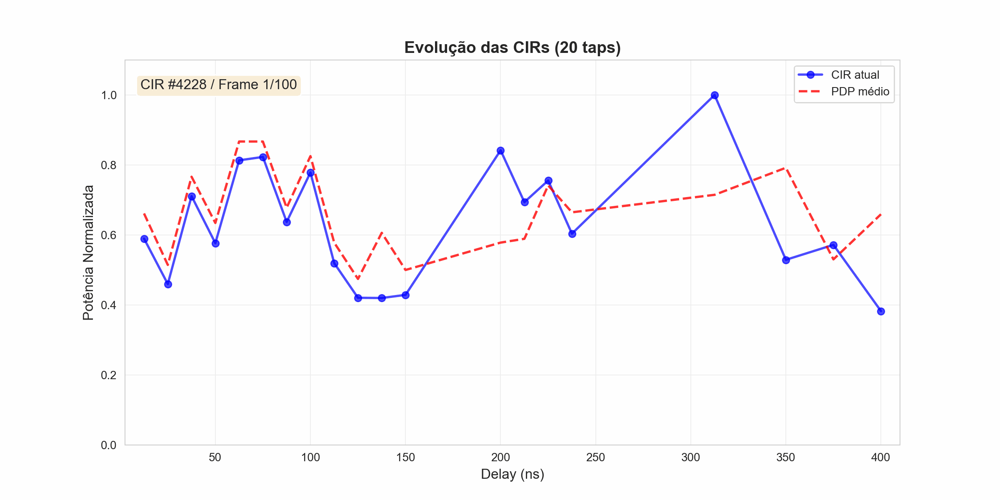

In [14]:
display(Markdown("### Animação: CIRs - 20 taps"))
display(Image(filename='../media/cir_animation_20taps.gif', width=700))

### Animação: CIRs - 8 taps

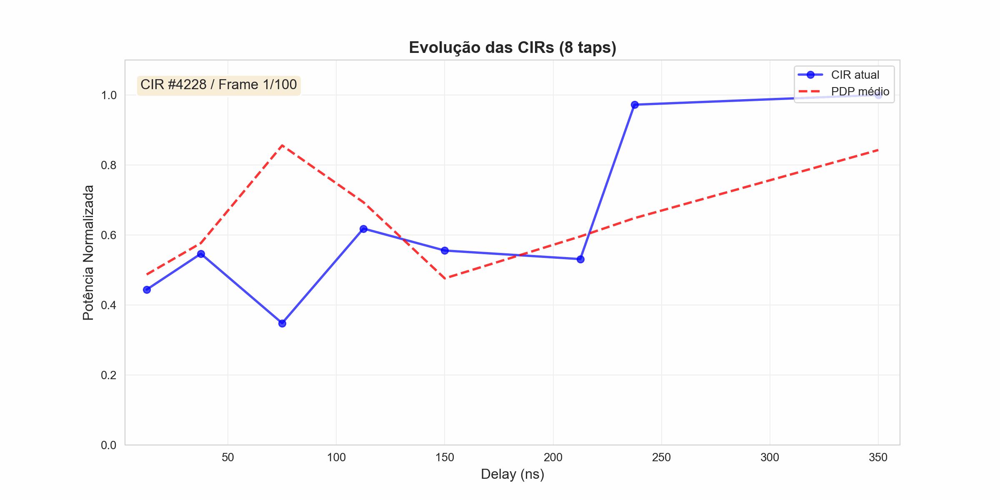

In [15]:
display(Markdown("### Animação: CIRs - 8 taps"))
display(Image(filename='../media/cir_animation_8taps.gif', width=700))

### Animação Comparativa: 20 vs 8 taps

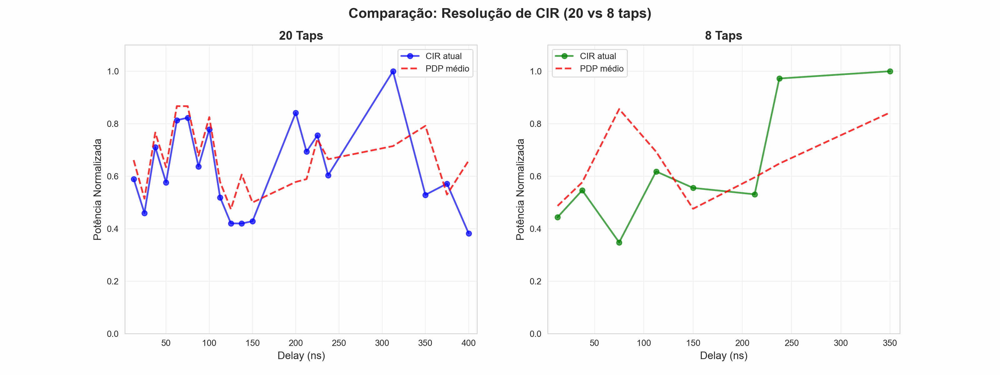

In [16]:
display(Markdown("### Animação Comparativa: 20 vs 8 taps"))
display(Image(filename='../media/cir_comparison_20vs8.gif', width=800))

## Conclusões - Parte II

### 1. Parâmetros Principais (20 taps)
- **Mean Excess Delay:** 162.66 ns
- **RMS Delay Spread:** 117.72 ns
- **Maximum Excess Delay:** 400 ns (threshold -20 dB)
- **Coherence BW (90%):** 0.17 MHz
- **Coherence BW (50%):** 1.70 MHz

### 2. Seletividade em Frequência
- Canal é **seletivo** para sinais > 1.7 MHz
- WiFi, 4G/5G: definitivamente seletivos
- Necessário equalização para banda larga

### 3. Influência da Resolução
- Diferenças de 3-12% nos parâmetros
- Maior impacto em Max Excess Delay (12%)
- Parâmetros principais (RMS DS, Bc) consistentes

---

# Parte III: Modelo Saleh-Valenzuela

## Objetivos
- Implementar modelo SV para geração de CIRs sintéticas
- Demonstrar efeito de cada parâmetro (Γ, γ, Λ, λ, K)
- Comparar NLOS vs LOS
- Gerar múltiplas realizações

## Exemplos com Diferentes Configurações

### Configurações Diferentes do Modelo SV

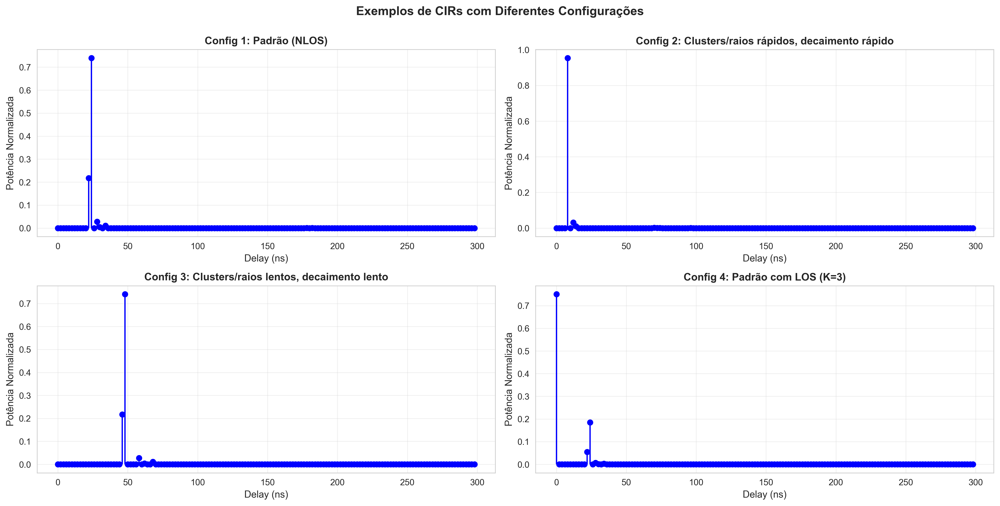

In [17]:
display(Markdown("### Configurações Diferentes do Modelo SV"))
display(Image(filename='../figures/parte3/sv_exemplos_configs.png', width=900))

## Estudo Paramétrico: Efeito Individual

### Variação de Γ (Gamma) - Taxa de chegada de clusters

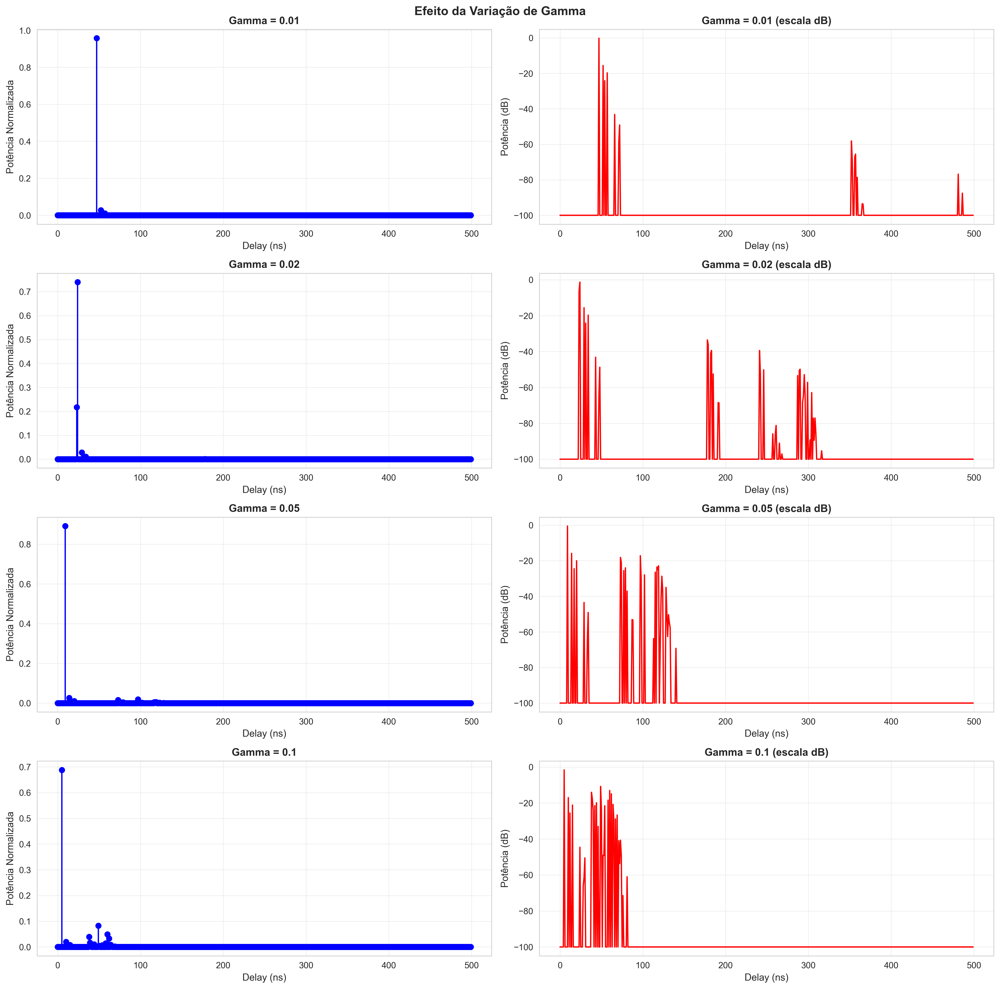

In [18]:
display(Markdown("### Variação de Γ (Gamma) - Taxa de chegada de clusters"))
display(Image(filename='../figures/parte3/sv_variacao_Gamma_clusters.png', width=900))

### Variação de γ (gamma) - Taxa de chegada de raios

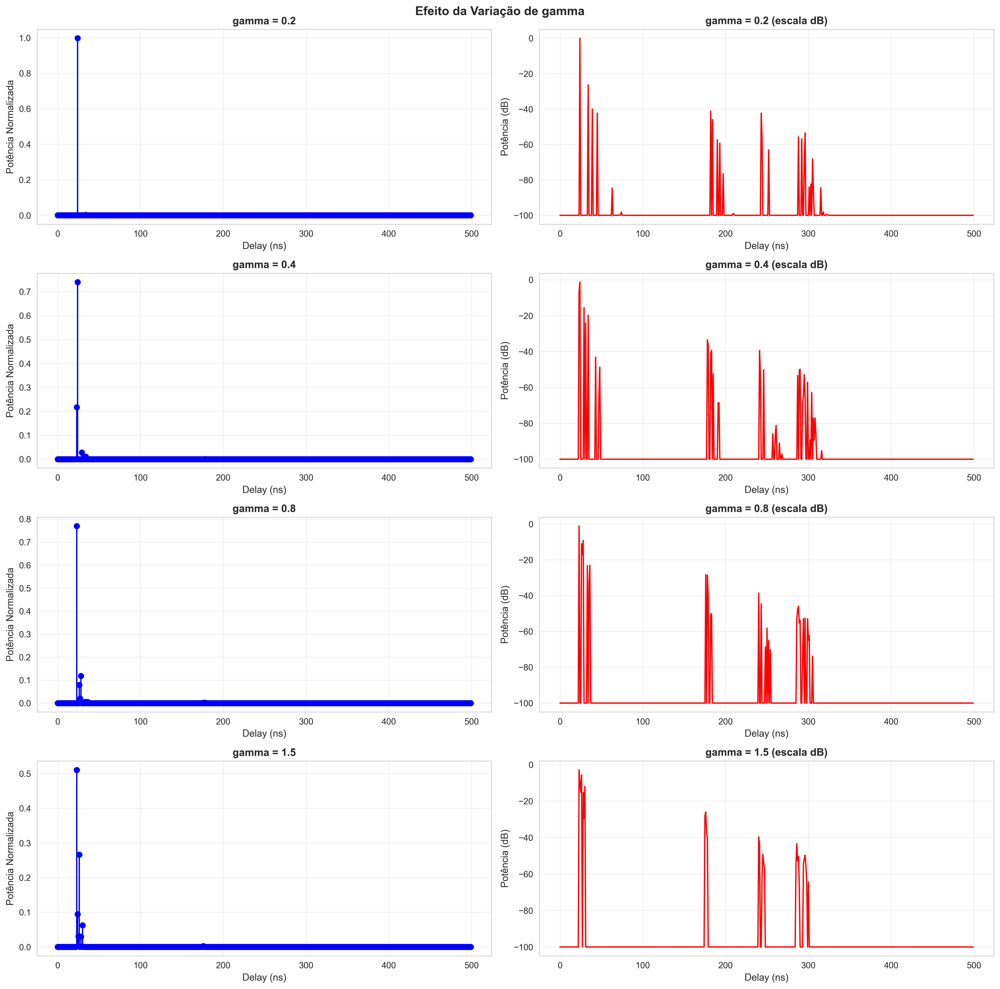

In [19]:
display(Markdown("### Variação de γ (gamma) - Taxa de chegada de raios"))
display(Image(filename='../figures/parte3/sv_variacao_gamma_raios.png', width=900))

### Variação de Λ (Lambda) - Decaimento de clusters

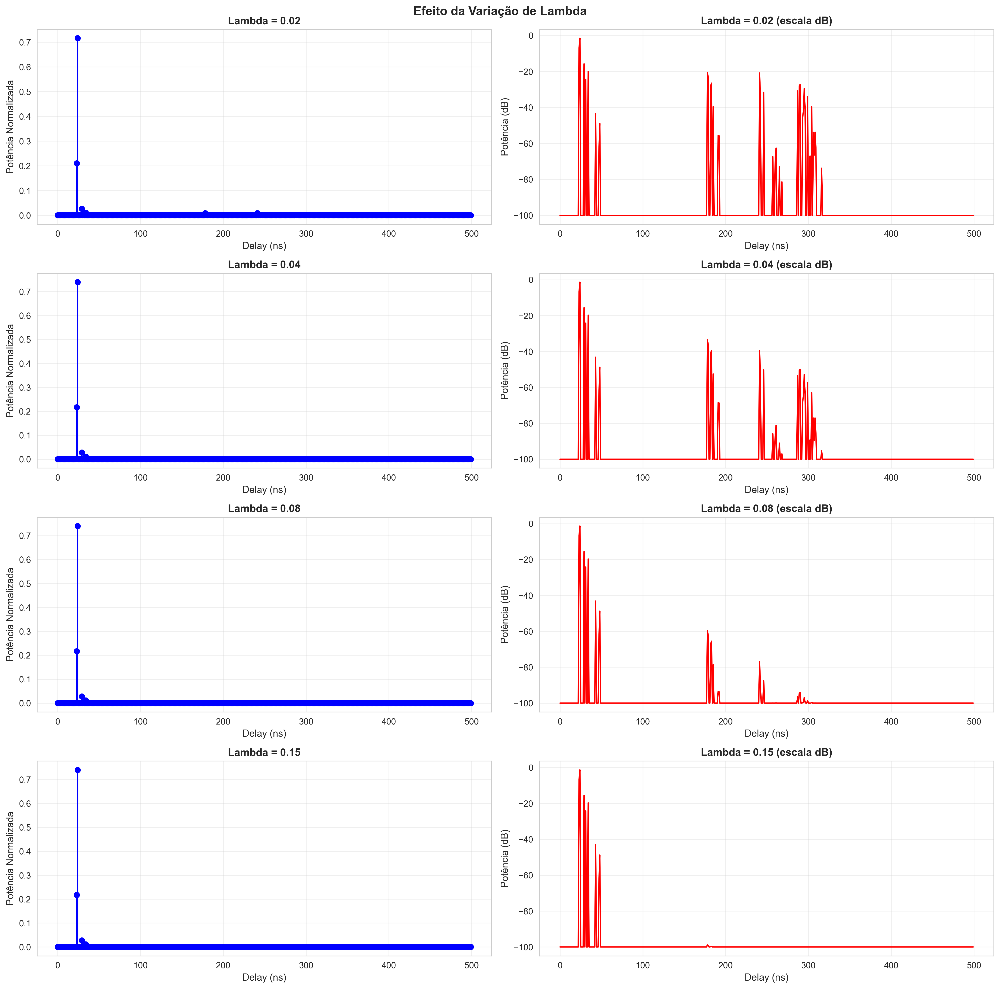

In [20]:
display(Markdown("### Variação de Λ (Lambda) - Decaimento de clusters"))
display(Image(filename='../figures/parte3/sv_variacao_Lambda_clusters.png', width=900))

### Variação de λ (lambda) - Decaimento de raios

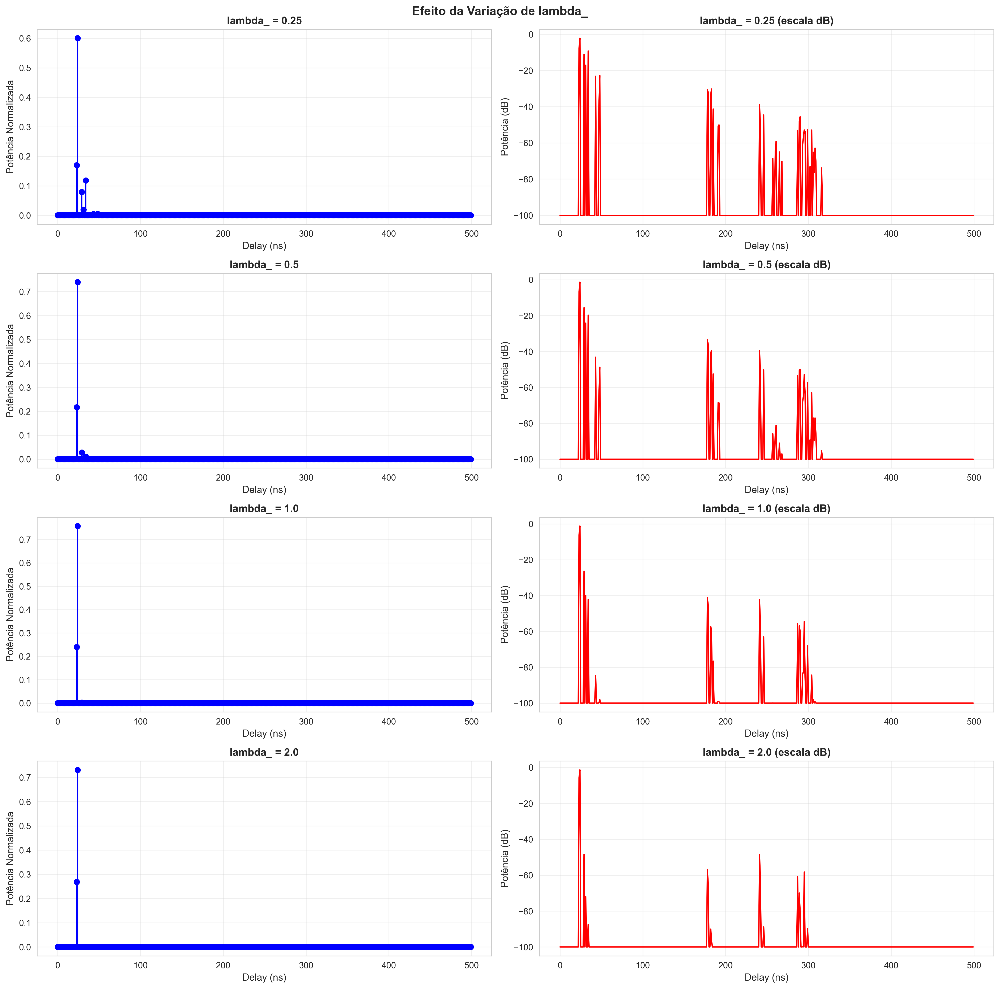

In [21]:
display(Markdown("### Variação de λ (lambda) - Decaimento de raios"))
display(Image(filename='../figures/parte3/sv_variacao_lambda_raios.png', width=900))

## Comparação de Todos os Parâmetros

### Efeito de Todos os Parâmetros

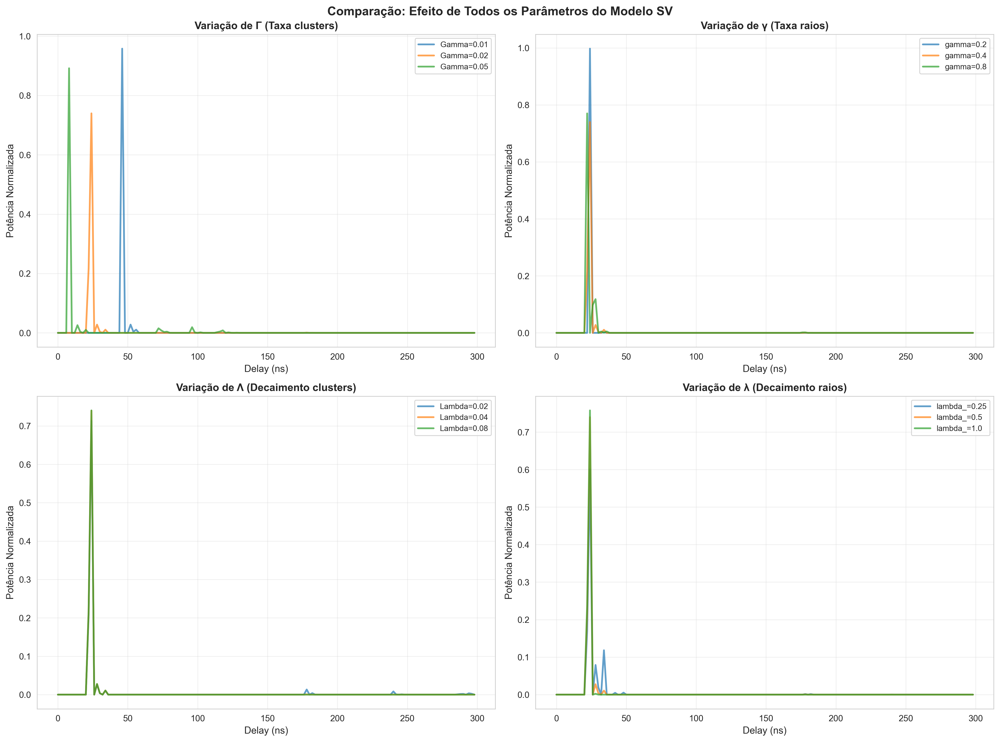

In [22]:
display(Markdown("### Efeito de Todos os Parâmetros"))
display(Image(filename='../figures/parte3/sv_comparacao_todos_parametros.png', width=900))

## NLOS vs LOS (Fator K)

### Comparação NLOS vs LOS

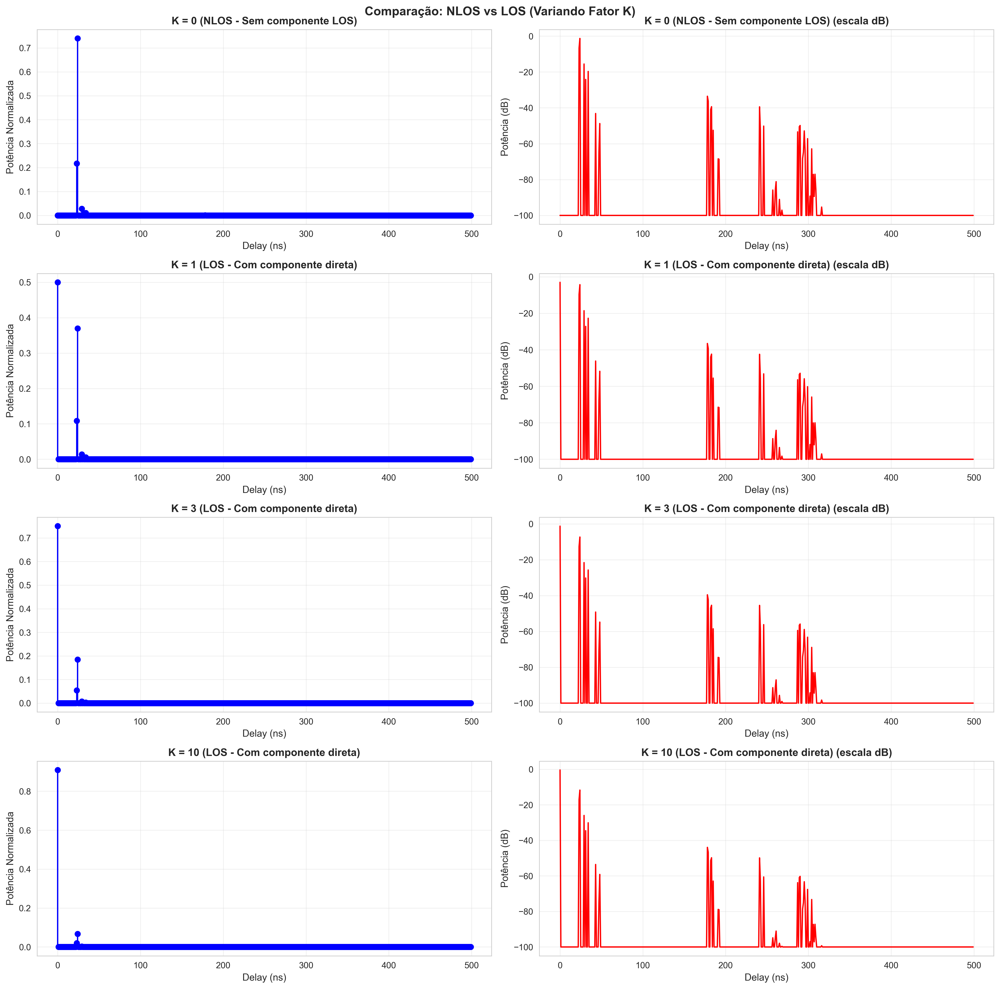

In [23]:
display(Markdown("### Comparação NLOS vs LOS"))
display(Image(filename='../figures/parte3/sv_nlos_vs_los.png', width=900))

## Múltiplas Realizações e PDP Médio

### 100 Realizações do Modelo SV

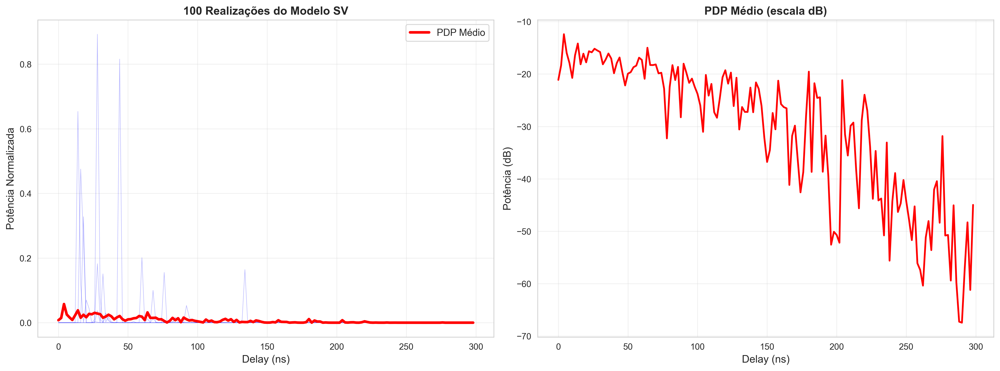

In [24]:
display(Markdown("### 100 Realizações do Modelo SV"))
display(Image(filename='../figures/parte3/sv_multiplas_realizacoes.png', width=900))

## Conclusões - Parte III

### 1. Modelo Implementado
- Processo de Poisson para tempos de chegada
- Decaimento exponencial de potência
- Suporte a LOS (fator K)

### 2. Efeito dos Parâmetros
- **Γ e γ:** Controlam densidade temporal (chegadas)
- **Λ e λ:** Controlam dispersão de potência (decaimentos)
- **K:** Controla presença de LOS (0=NLOS, K>0=LOS)

### 3. Aplicações
- Geração de canais sintéticos para simulações
- Teste de sistemas de comunicação
- Modelagem de ambientes indoor específicos

---

# Conclusões Gerais

## Síntese dos Resultados

### Parte I - Distribuições Estatísticas
✅ **Melhor modelo:** Nakagami-m (m ≈ 0.3)  
✅ **Característica:** Desvanecimento severo (m < 1)  
✅ **Ambiente:** NLOS, multipercurso rico

### Parte II - Parâmetros do Canal
✅ **RMS Delay Spread:** ~117.7 ns  
✅ **Coherence Bandwidth:** 1.7 MHz (50%)  
✅ **Seletividade:** Canal seletivo para sinais > 1.7 MHz

### Parte III - Modelo Saleh-Valenzuela
✅ **Implementação completa** do modelo SV  
✅ **Análise paramétrica** de Γ, γ, Λ, λ, K  
✅ **NLOS vs LOS** demonstrado

---

## Interpretação Física

O ambiente Steam Plant (NIST) apresenta:

1. **Multipercurso rico e severo**
   - Desvanecimento pior que Rayleigh (m < 1)
   - Ambiente industrial com muitas reflexões

2. **Ausência de linha de visada**
   - K ≈ 0 confirma NLOS
   - Obstáculos bloqueiam LOS

3. **Dispersão temporal significativa**
   - RMS DS > 100 ns
   - Equalização necessária para banda larga

4. **Seletividade em frequência**
   - WiFi, 4G/5G sofrem desvanecimento seletivo
   - Técnicas como OFDM são essenciais

---

## Aplicações Práticas

**Projeto de Sistemas:**
- Banda estreita (< 1.7 MHz): modelar como canal plano
- Banda larga (> 1.7 MHz): usar equalização

**Simulações:**
- Modelo SV para canais sintéticos
- Parâmetros ajustados a partir de medidas reais

**Planejamento:**
- Considerar m < 1 no link budget
- Prever diversidade (espacial/temporal/frequencial)

---

## Arquivos Gerados

**Total: 29 arquivos**
- 18 figuras (PNG, 300 DPI)
- 3 animações (GIF)
- 5 resultados (CSV)
- 3 scripts executáveis

---

## Referências

1. **NIST Dataset:** Industrial Wireless Systems Radio Propagation Measurements
2. **Saleh & Valenzuela (1987):** "A statistical model for indoor multipath propagation"
3. **Dissertação:** Envoltória normalizada
4. **Nakagami (1960):** "The m-distribution"
5. **Rappaport (2002):** "Wireless Communications: Principles and Practice"

---

**FIM DO NOTEBOOK**